In [1]:
from torchvision import models

In [2]:
# dir(models) 

In [3]:
restnet = models.resnet34(pretrained=True)

In [4]:
type(restnet)

torchvision.models.resnet.ResNet

In [243]:
restnet.modules

<bound method Module.modules of ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

In [6]:
# check that the out_features is 1000, this is the output that have in the model

In [7]:
from torchvision import transforms
preprocess = transforms.Compose(
   [transforms.Resize(256),
    transforms.CenterCrop(224), # resize the images towards the center
    transforms.ToTensor(), #transforming the image to a tensor
    transforms.Normalize(
    mean=[0.485, 0.456, 0.406], # why are we normalizing with these weights?
    std=[0.229, 0.224, 0.225])]
)

In [8]:
from PIL import Image
img = Image.open('./data/foods/pizza/00000001.jpg')

In [9]:
tensorito = transforms.Compose([transforms.ToTensor()])

In [10]:
tensorito(img)

tensor([[[0.2863, 0.2863, 0.2824,  ..., 0.1020, 0.1059, 0.1098],
         [0.2863, 0.2824, 0.2824,  ..., 0.1059, 0.1098, 0.1137],
         [0.2824, 0.2824, 0.2824,  ..., 0.1098, 0.1137, 0.1137],
         ...,
         [0.7255, 0.7216, 0.7255,  ..., 0.4039, 0.4039, 0.4078],
         [0.7255, 0.7216, 0.7255,  ..., 0.4039, 0.4078, 0.4118],
         [0.7333, 0.7255, 0.7255,  ..., 0.4078, 0.4118, 0.4157]],

        [[0.2235, 0.2235, 0.2196,  ..., 0.0392, 0.0431, 0.0471],
         [0.2235, 0.2196, 0.2196,  ..., 0.0431, 0.0471, 0.0510],
         [0.2196, 0.2196, 0.2196,  ..., 0.0471, 0.0510, 0.0510],
         ...,
         [0.4235, 0.4196, 0.4235,  ..., 0.1608, 0.1608, 0.1647],
         [0.4235, 0.4196, 0.4235,  ..., 0.1608, 0.1647, 0.1686],
         [0.4314, 0.4235, 0.4235,  ..., 0.1647, 0.1686, 0.1725]],

        [[0.2627, 0.2627, 0.2588,  ..., 0.0392, 0.0431, 0.0471],
         [0.2627, 0.2588, 0.2588,  ..., 0.0431, 0.0471, 0.0510],
         [0.2588, 0.2588, 0.2588,  ..., 0.0471, 0.0510, 0.

In [11]:
import os

In [12]:
# os.listdir('./data/foods/pizza')

In [13]:
type(img)

PIL.JpegImagePlugin.JpegImageFile

In [14]:
img_t = preprocess(img)

In [15]:
type(img)

PIL.JpegImagePlugin.JpegImageFile

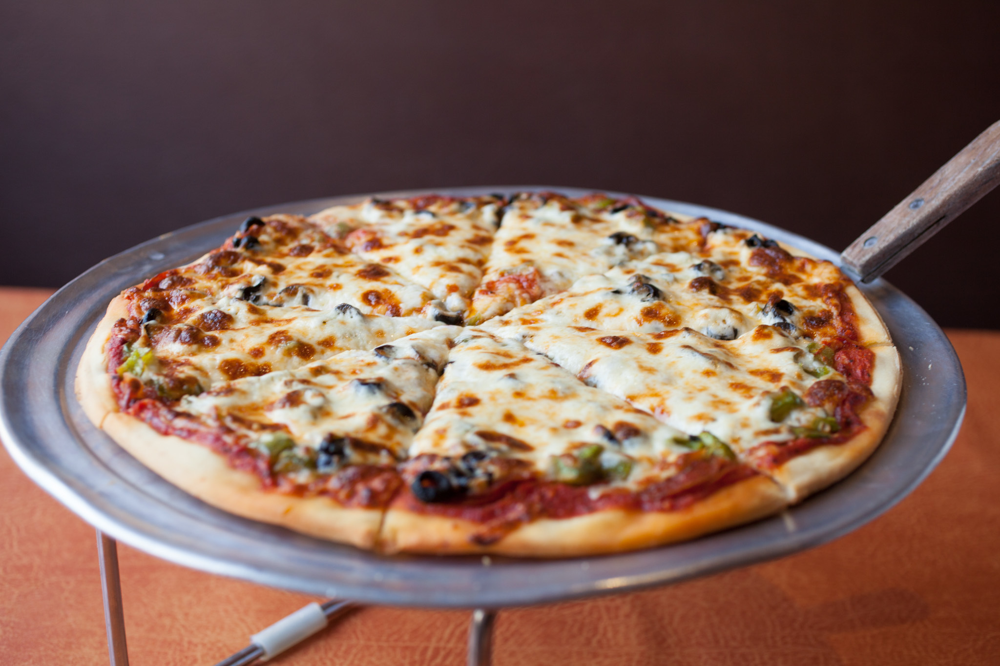

In [16]:
img

In [17]:
type(img_t)

torch.Tensor

In [18]:
import matplotlib.pyplot as plt

In [19]:
img_t.shape

torch.Size([3, 224, 224])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


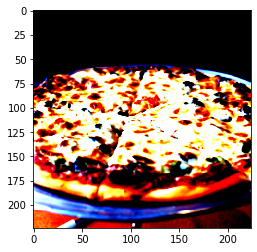

In [20]:
plt.imshow(img_t.permute([1,2,0]))

In [21]:
# importing the labels of the restnet model
with open('./data/imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]

In [22]:
import torch
batch_t = torch.unsqueeze(img_t, 0) # transforms from [3, 224, 224] to torch.Size([1, 3, 224, 224])
batch_t.size()

torch.Size([1, 3, 224, 224])

## Before processing the image through the network we need to set the network in Eval mode

In [23]:
# restnet.eval() # BEFORE DOING INFERENCE WE NEED TO PUT THE NETWORK IN EVAL MODE

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [24]:
# out = restnet(batch_t)

In [26]:
# out.shape  # we are getting an output of size [1, 1000]

In [26]:
# Converting original image to a tensor and then getting a [1, 1000] embedding
# img_original_out = restnet(torch.unsqueeze(tensorito(img), 0))

In [27]:
# Distance between orignal image and prepocessed one
# torch.dist(out, img_original_out) 

### Getting the label for the prepocessed image in the Restnet34 network

In [28]:
_, index = torch.max(out, 1)

In [29]:
index

tensor([963])

In [30]:
labels[963]

'pizza, pizza pie'

In [31]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('pizza, pizza pie', 99.88385009765625)

In [32]:
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('pizza, pizza pie', 99.88385009765625),
 ('bagel, beigel', 0.024583226069808006),
 ('potpie', 0.02184840850532055),
 ('frying pan, frypan, skillet', 0.01881106197834015),
 ('trifle', 0.010392923839390278)]

### Testing for the original image without prepocessing (Does not work - bad labelling)

In [33]:
_, index = torch.max(img_original_out, 1)

In [34]:
index

tensor([813])

In [35]:
# WITHOUT PRE-PROCESSING THIS HAS NOT WORKED!
percentage = torch.nn.functional.softmax(img_original_out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item()

('spatula', 6.684434413909912)

How can I load a databunch of images and generate the vectors automatically?

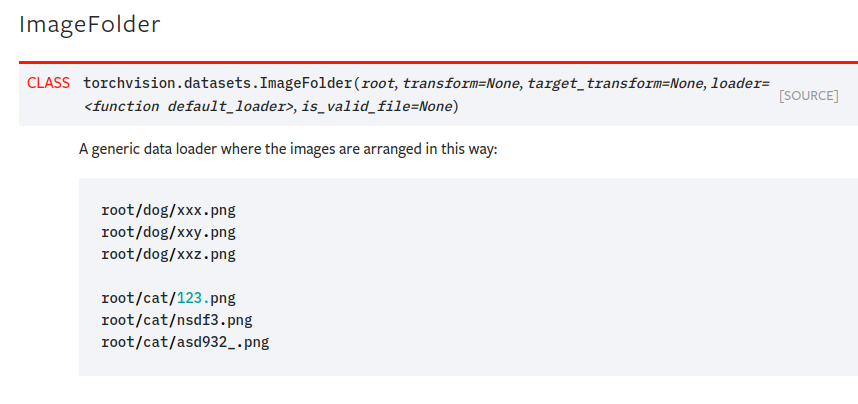

https://pytorch.org/docs/stable/torchvision/datasets.html#imagefolder

### Transformations for the images

In [33]:
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torch.nn as nn


transform = transforms.Compose(
    [transforms.Resize([256, 256]),
    transforms.CenterCrop(224),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

resnet = models.resnet34(pretrained=True)

### Using *datasets* first because this is needed for DataLoader

In [38]:
os.listdir('./data/foods/')

['hamburger', 'pizza', 'pasta', 'foods2']

In [64]:
data_food = ImageFolder(
    './data/foods',
    transform=transform)

In [65]:
data_food[0][0].shape

torch.Size([3, 224, 224])

In [66]:
data_food.classes

['foods2', 'hamburger', 'pasta', 'pizza']

In [67]:
data_food[0][0].shape

torch.Size([3, 224, 224])

In [68]:
type(data_food)

torchvision.datasets.folder.ImageFolder

In [70]:
len(data_food)

2794

In [71]:
dl = DataLoader(data_food, batch_size=1, num_workers=3)

In [72]:
for b  in dl:
    break

In [73]:
b[0]

tensor([[[[-0.9137, -0.9216, -0.9137,  ..., -0.3020, -0.3020, -0.3098],
          [-0.9137, -0.9137, -0.9059,  ..., -0.3098, -0.3176, -0.3176],
          [-0.9059, -0.9137, -0.9137,  ..., -0.3333, -0.3255, -0.3333],
          ...,
          [-0.3020, -0.2784, -0.3255,  ...,  0.3255,  0.2863,  0.2235],
          [-0.2078, -0.1686, -0.2157,  ...,  0.2549,  0.2549,  0.2157],
          [-0.3569, -0.2706, -0.2706,  ...,  0.2314,  0.2471,  0.2157]],

         [[-0.9137, -0.9216, -0.9137,  ..., -0.3569, -0.3569, -0.3804],
          [-0.9137, -0.9137, -0.9059,  ..., -0.3647, -0.3725, -0.3882],
          [-0.9059, -0.9137, -0.9137,  ..., -0.3961, -0.3882, -0.4039],
          ...,
          [-0.4824, -0.4824, -0.5137,  ...,  0.2000,  0.1529,  0.0980],
          [-0.4118, -0.3804, -0.4196,  ...,  0.1137,  0.1059,  0.0667],
          [-0.5451, -0.4588, -0.4588,  ...,  0.0902,  0.0980,  0.0667]],

         [[-0.9137, -0.9059, -0.8980,  ..., -0.4353, -0.4353, -0.4510],
          [-0.9137, -0.8980, -

In [74]:
dl.dataset

Dataset ImageFolder
    Number of datapoints: 2794
    Root location: ./data/foods
    StandardTransform
Transform: Compose(
               Resize(size=[256, 256], interpolation=PIL.Image.BILINEAR)
               CenterCrop(size=(224, 224))
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )

In [75]:
b[0].shape # Notice that 16 is the batch size of the DataLoader

torch.Size([1, 3, 224, 224])

Now that I have the images in a DataLoader, what we need to do is to pass this through the RestNet.

The problem is that the resnet, is ending with a FC (Fully Connected) layer where you are getting the probabilites of each one of the images being a specific label.

Instead, the only thing that we need is the layer before:

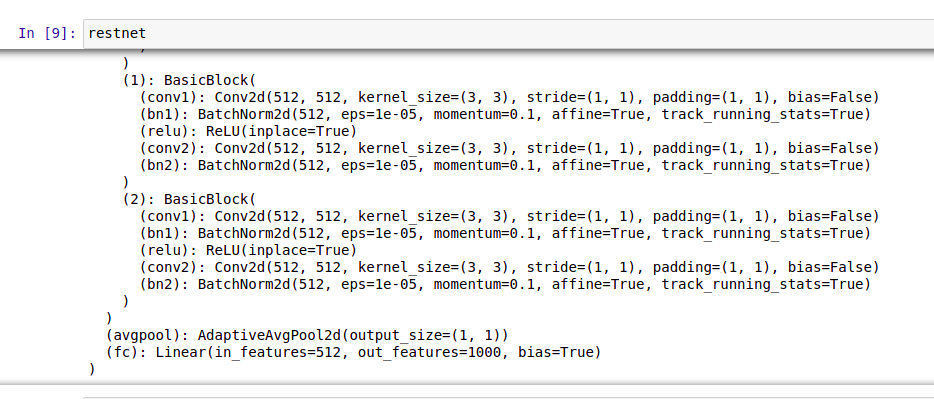

In [77]:
# list(restnet.modules()[:,:,-1])

In [79]:
# from torchvision.models.resnet  import resnet50
# resnet =resnet50(pretrained=)


# list(resnet.modules())[]

Code from Jakub on how to CUT the neural network, what are doing is just selecting all but the last one

## Copy of resnet_food

In [58]:
#resnet_food

In [59]:
resnet_food(b[0])[0].shape

torch.Size([512, 1, 1])

In [60]:
## TOO MANY WEIGHTS.

In [61]:
resnet_food(b[0])[0].reshape(-1).shape

torch.Size([512])

In [63]:
#resnet_food(b[0])[0].reshape(-1)

In [64]:
resnet_food(b[0])[0].shape

torch.Size([512, 1, 1])

In [ ]:
# embedding_pics = {}
# counter = 0
# for b in dl:
# #     print(counter)
#     embedding_pics[counter] = resnet_food(b[0])[0].reshape(-1)
#     counter += 1

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243


/home/neuralcrypto/anaconda3/lib/python3.7/site-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268


/home/neuralcrypto/anaconda3/lib/python3.7/site-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404
405
406
407
408
409
410
411
412
413
414
415
416
417
418
419
420
421
422
423
424
425
426
427
428
429
430
431
432
433
434
435
436
437
438
439
440
441
442
443
444
445
446
447
448
449
450
451
452
453
454
455
456
457
458
459
460
461
462
463
464
465
466
467
468
469
470
471
472
473
474
475
476
477
478
479
480
481
482
483
484
485
486
487
488
489
490
491
492
493
494
495
496
497
498
499
500
501
502
503
504
505
506
507
508
509
510
511
512
513
514
515
516
517
518


## I just realized that I should split the dataset into the classes, otherwise the hashing table is going to be too large

In [36]:
import torch.nn as nn

In [39]:
data_food_hamburger = ImageFolder(
    './data/foods/foods2/hamburger2',
    transform=transform)

In [40]:
resnet_food = nn.Sequential(*list(resnet.children())[:-1])

In [41]:
dl_hamburger = DataLoader(data_food_hamburger, batch_size=1, num_workers=3)

In [174]:
dl_hamburger.dataset.imgs[35][0]

'./data/foods/foods2/hamburger2/hamburger/00000038.jpg'

In [42]:
embedding_pics_hamburger = {}
counter = 0
for b in dl_hamburger:
#     print(counter)
    embedding_pics_hamburger[counter] = resnet_food(b[0])[0].reshape(-1)
    counter += 1

/home/neuralcrypto/anaconda3/lib/python3.7/site-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/home/neuralcrypto/anaconda3/lib/python3.7/site-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


In [76]:
b[0].shape

torch.Size([1, 3, 224, 224])

### How could I save the whole dictionary?

In [43]:
len(embedding_pics_hamburger)

455

## PLEASE notice that every time you are passing an input through the restnet, you are giving a tensor in [1, 3, 224, 224]

### Looks like I always need to transform a [3, 224, 224] img into a tensor [1, 3, 224, 224]
torch.unsqueeze(tensor of shape[3, 224, 224] , 0)

In [44]:
# import torch
# batch_t = torch.unsqueeze(b[0], 0) # transforms from [3, 224, 224] to torch.Size([1, 3, 224, 224])
# batch_t.size()

In [115]:
[torch.dist(embedding_pics_hamburger[0], embedding_pics_hamburger[i]) for i in range(0,len(embedding_pics_hamburger) )\
 if torch.dist(embedding_pics_hamburger[0], embedding_pics_hamburger[i]) < 1]

[tensor(0., grad_fn=<DistBackward>)]

In [47]:
import numpy as np

In [217]:
repeated_array = np.concatenate([repeated_array.reshape(2, -1), np.array([1,2]).reshape(1, 2)], axis=0)

ValueError: all the input array dimensions for the concatenation axis must match exactly, but along dimension 1, the array at index 0 has size 1 and the array at index 1 has size 2

In [216]:
repeated_array

array([None, None], dtype=object)

In [48]:
counter = 0
repeated_images=[]
repeated_array = np.array([None, None])
for i, emb in enumerate(embedding_pics_hamburger.values()):
    
    # The index of the embedding
#     print('START')
#     print(i)
    
    # Creating a list without the actual img index 
    # This piece of code is quite nice, but I am sure there is a nicer way of coding
    list_loops = list(range(len(embedding_pics_hamburger)))
    list_loops.pop(i)
    
    #just a range
    for j in list_loops:
        
        if torch.dist(emb, embedding_pics_hamburger[j]) < 1.5:
            print(f'Img{i} is == Img{j} by {torch.dist(emb, embedding_pics_hamburger[j])} ')
    
            repeated_array = np.concatenate([repeated_array, np.array([i,j])])

Img57 is == Img206 by 0.2302824705839157 
Img57 is == Img297 by 0.23220114409923553 
Img66 is == Img185 by 0.22493675351142883 
Img77 is == Img93 by 0.0 
Img78 is == Img103 by 0.0 
Img79 is == Img94 by 0.0 
Img80 is == Img98 by 0.0 
Img81 is == Img112 by 0.0 
Img81 is == Img238 by 0.26765936613082886 
Img82 is == Img118 by 0.0 
Img83 is == Img102 by 0.0 
Img84 is == Img134 by 0.0 
Img85 is == Img119 by 0.0 
Img86 is == Img96 by 0.0 
Img86 is == Img242 by 0.5455670356750488 
Img87 is == Img135 by 0.0 
Img88 is == Img126 by 0.0 
Img89 is == Img105 by 0.0 
Img90 is == Img107 by 0.0 
Img91 is == Img111 by 0.0 
Img92 is == Img120 by 0.0 
Img93 is == Img77 by 0.0 
Img94 is == Img79 by 0.0 
Img96 is == Img86 by 0.0 
Img96 is == Img242 by 0.5455670356750488 
Img98 is == Img80 by 0.0 
Img102 is == Img83 by 0.0 
Img103 is == Img78 by 0.0 
Img105 is == Img89 by 0.0 
Img107 is == Img90 by 0.0 
Img111 is == Img91 by 0.0 
Img112 is == Img81 by 0.0 
Img112 is == Img238 by 0.26765936613082886 
Img117 

In [49]:
pairs_repeated = repeated_array.reshape(-1, 2)[1:]

In [50]:
images_to_delete = []
for i, pair in enumerate(pairs_repeated):
    if pair[0] < pair[1]:
        images_to_delete.append(pair[1])

In [51]:
pairs_repeated

array([[57, 206],
       [57, 297],
       [66, 185],
       [77, 93],
       [78, 103],
       [79, 94],
       [80, 98],
       [81, 112],
       [81, 238],
       [82, 118],
       [83, 102],
       [84, 134],
       [85, 119],
       [86, 96],
       [86, 242],
       [87, 135],
       [88, 126],
       [89, 105],
       [90, 107],
       [91, 111],
       [92, 120],
       [93, 77],
       [94, 79],
       [96, 86],
       [96, 242],
       [98, 80],
       [102, 83],
       [103, 78],
       [105, 89],
       [107, 90],
       [111, 91],
       [112, 81],
       [112, 238],
       [117, 319],
       [118, 82],
       [119, 85],
       [120, 92],
       [126, 88],
       [134, 84],
       [135, 87],
       [137, 383],
       [162, 190],
       [163, 229],
       [164, 188],
       [166, 209],
       [166, 405],
       [167, 203],
       [168, 198],
       [169, 186],
       [170, 189],
       [172, 196],
       [173, 192],
       [174, 199],
       [175, 201],
       [176, 193],
 

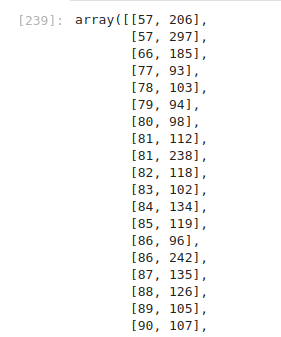

In [59]:
#not sure 100%
len(images_to_delete), len(set(images_to_delete))

(76, 71)

In [64]:
images_to_delete_np = np.array(list(set(images_to_delete)))
images_to_delete_np

array([384, 134, 135, 403, 405, 277, 278, 279, 281, 282, 280, 284, 283,
       286, 291, 378, 297, 185, 186, 187, 188, 189, 190, 319, 192, 193,
       313, 447, 196, 198, 199, 200, 201, 202, 203, 205, 206, 207, 208,
       209, 211, 219,  93,  94, 375,  96,  98, 376, 229, 102, 103, 105,
       377, 107, 238, 111, 112, 369, 242, 370, 371, 372, 118, 119, 120,
       374, 373, 379, 380, 126, 383])

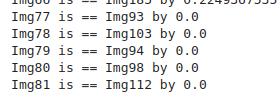

In [135]:
# dl_hamburger.dataset[77][0] - dl_hamburger.dataset[93][0] [This equals 0]

## Visualization of Images

In [136]:
import matplotlib.pyplot as plt

/home/neuralcrypto/anaconda3/lib/python3.7/site-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


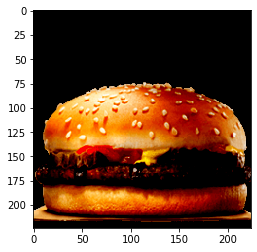

In [56]:
plt.imshow(dl_hamburger.dataset[454][0].permute([1, 2, 0]))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


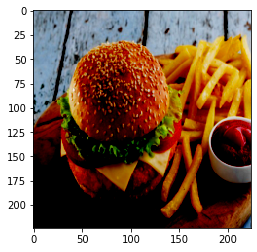

In [153]:
plt.imshow(dl_hamburger.dataset[209][0].permute([1, 2, 0]))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


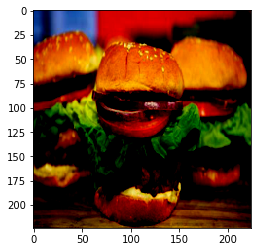

In [147]:
plt.imshow(dl_hamburger.dataset[242][0].permute([1, 2, 0]))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


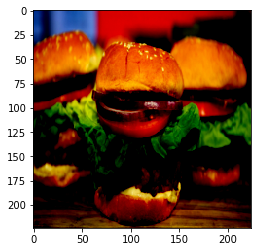

In [148]:
plt.imshow(dl_hamburger.dataset[86][0].permute([1, 2, 0]))

### Script to show all the pairs of repeated images, nonetheless, I need to change the structure of my data.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


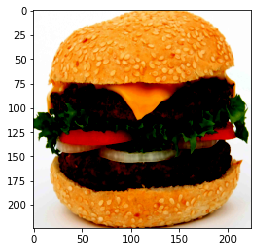

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


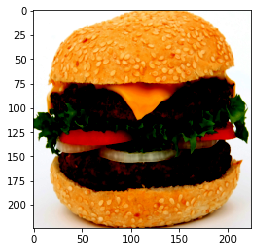

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


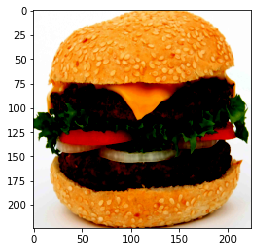

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


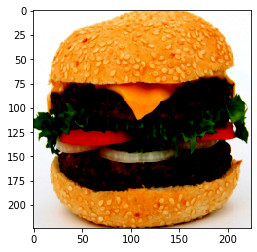

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


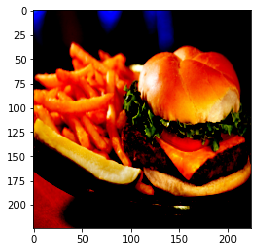

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


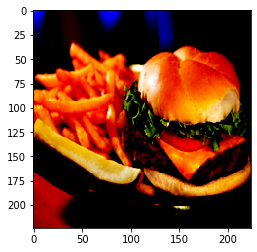

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


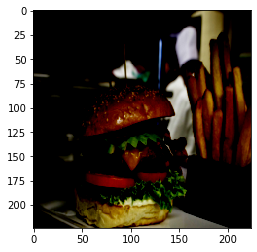

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


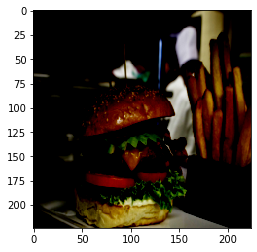

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


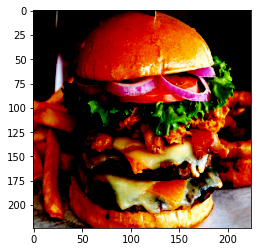

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


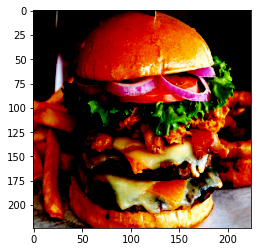

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


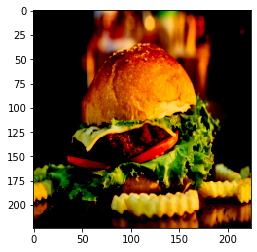

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


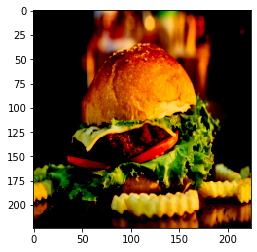

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


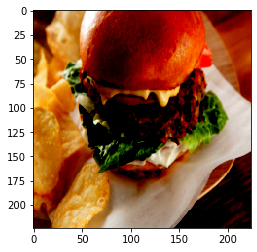

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


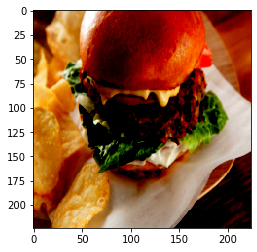

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


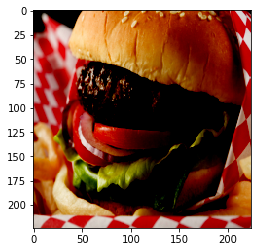

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


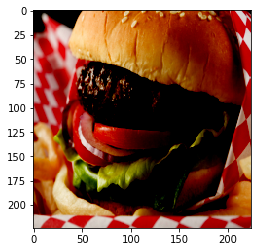

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


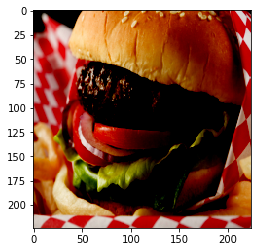

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


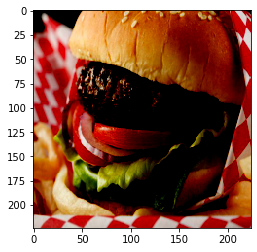

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


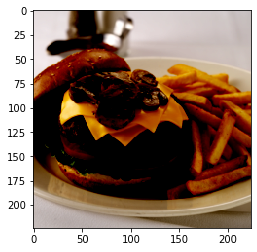

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


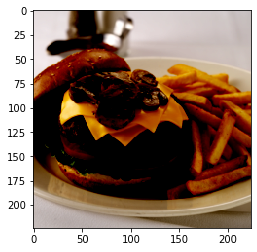

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


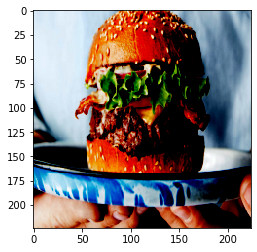

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


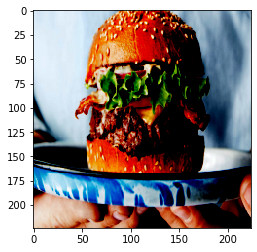

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


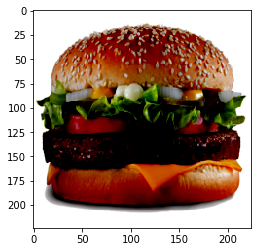

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


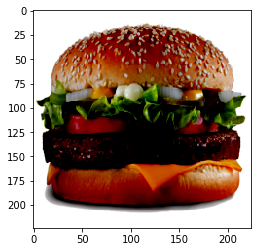

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


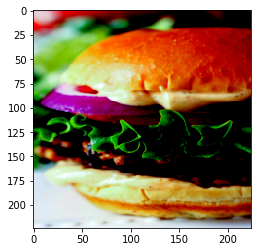

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


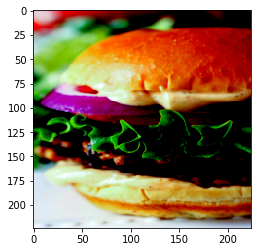

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


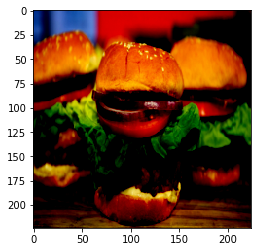

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


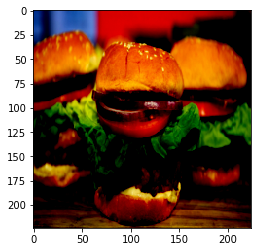

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


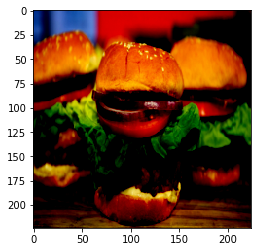

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


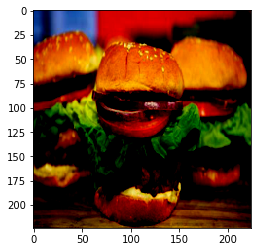

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


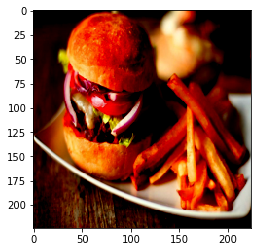

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


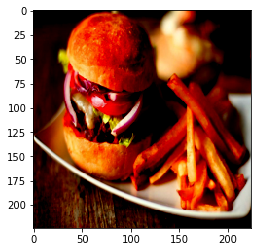

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


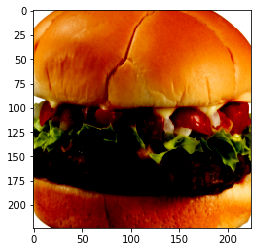

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


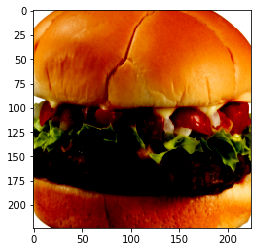

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


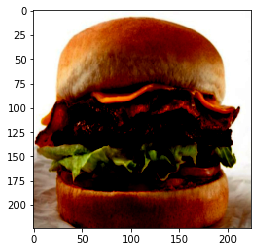

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


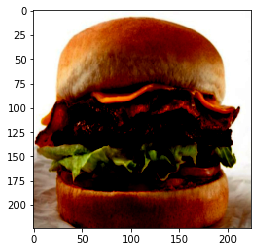

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


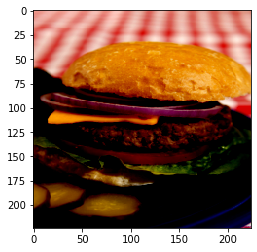

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


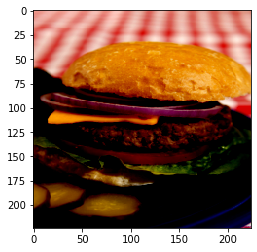

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


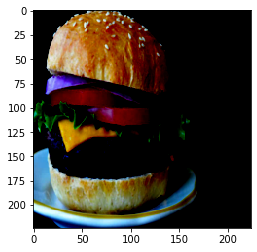

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


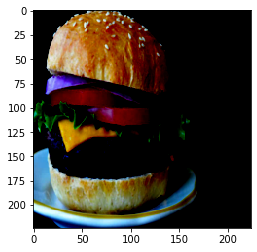

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


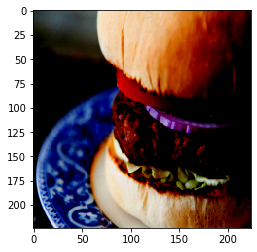

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


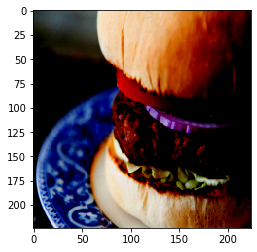

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


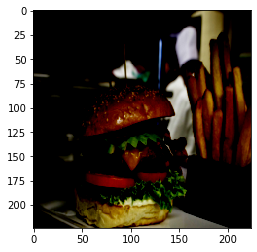

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


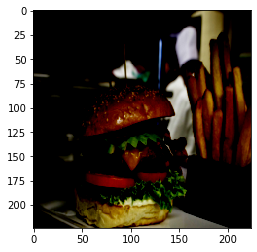

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


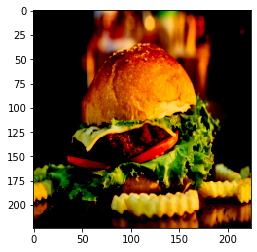

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


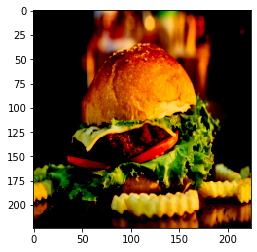

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


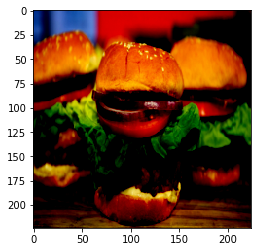

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


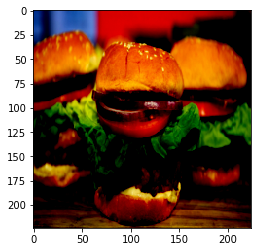

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


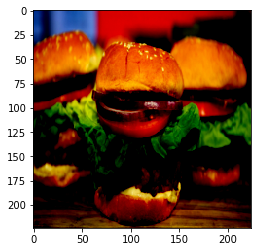

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


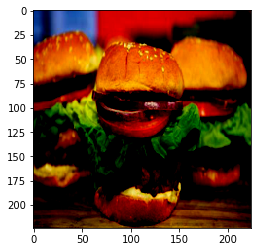

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


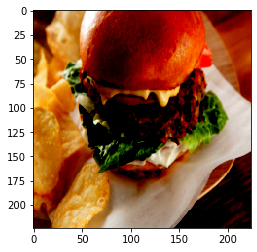

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


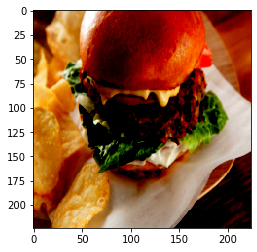

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


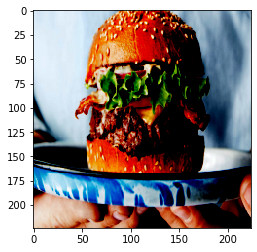

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


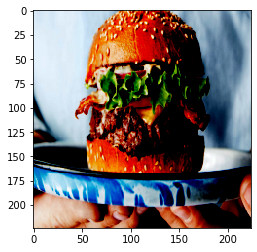

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


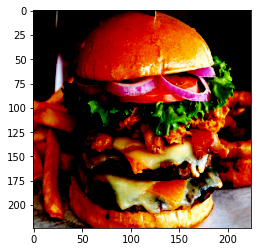

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


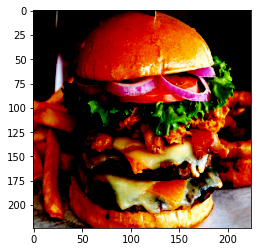

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


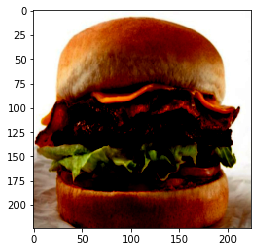

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


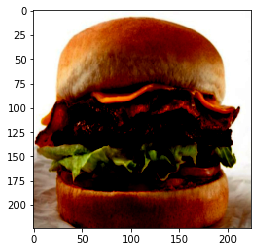

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


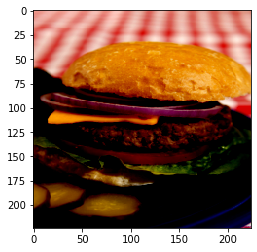

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


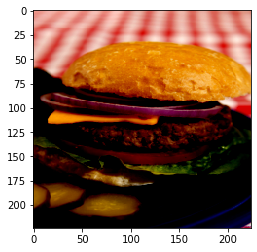

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


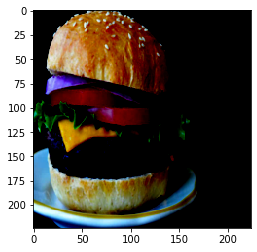

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


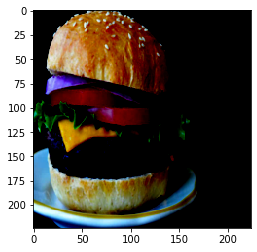

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


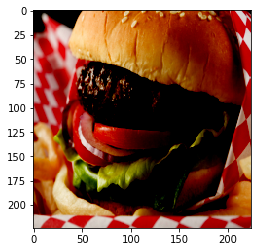

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


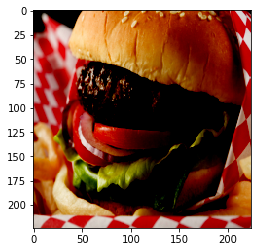

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


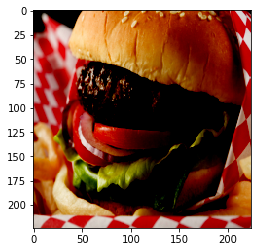

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


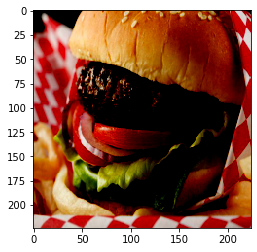

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


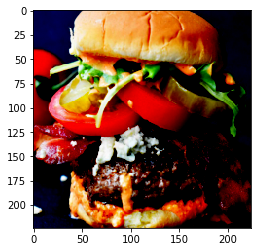

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


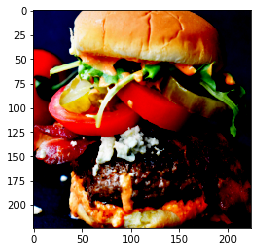

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


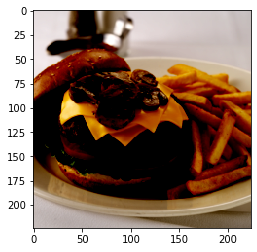

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


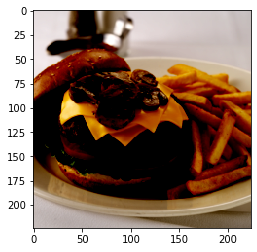

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


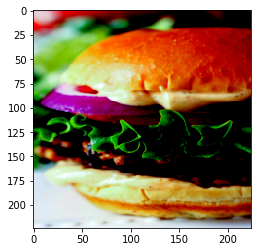

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


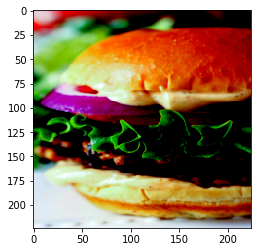

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


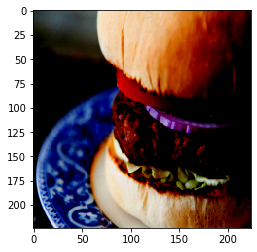

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


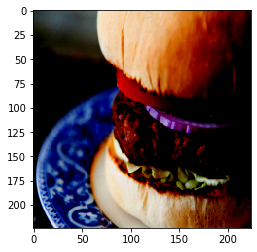

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


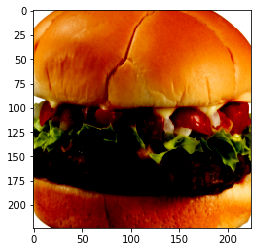

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


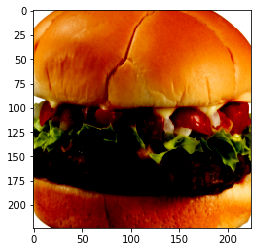

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


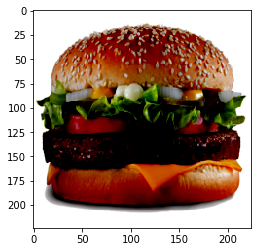

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


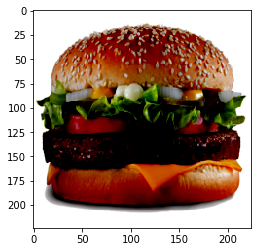

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


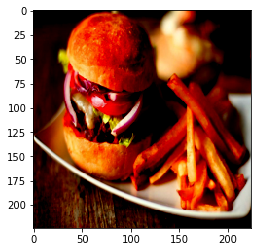

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


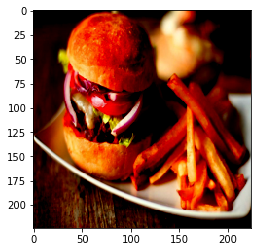

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


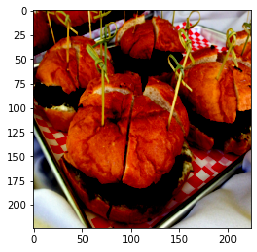

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


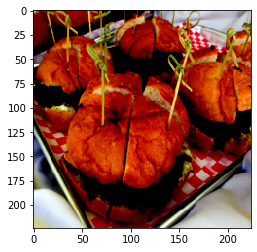

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


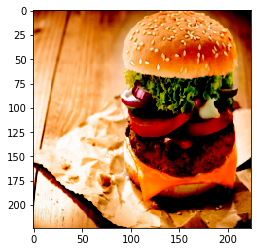

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


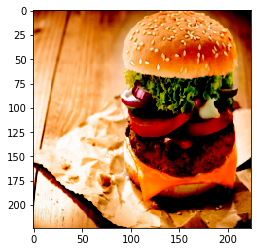

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


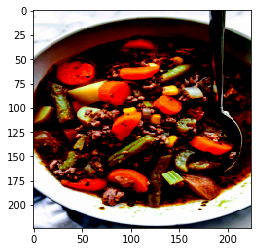

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


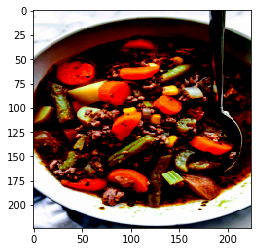

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


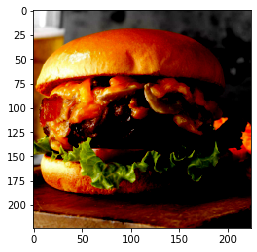

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


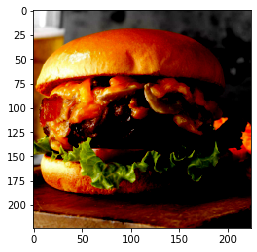

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


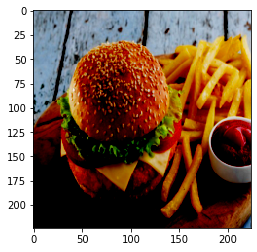

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


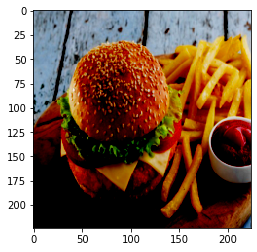

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


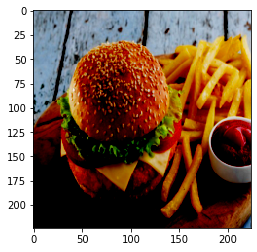

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


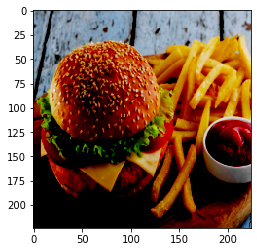

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


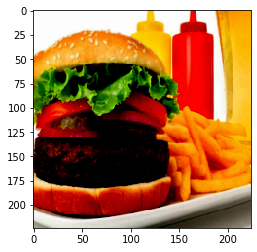

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


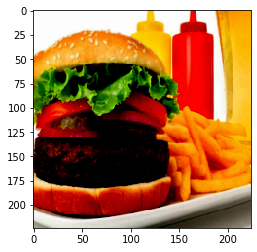

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


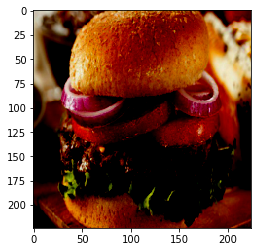

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


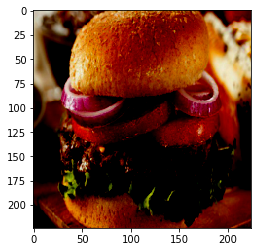

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


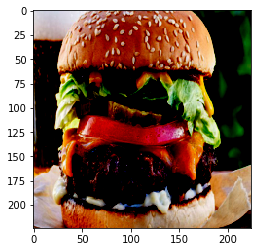

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


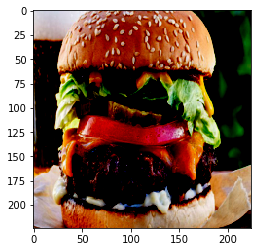

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


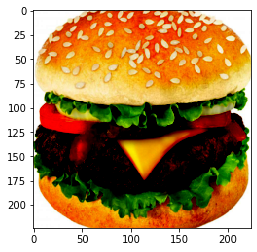

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


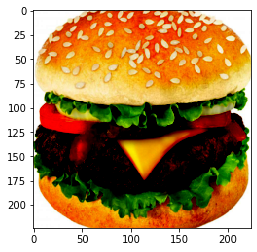

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


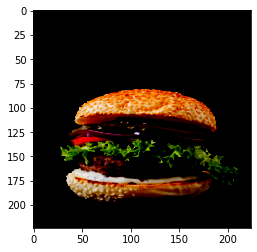

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


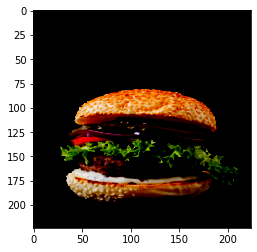

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


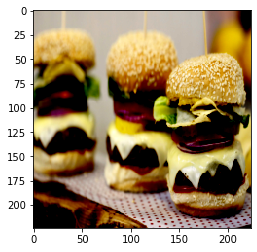

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


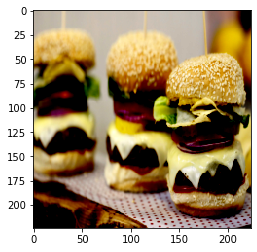

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


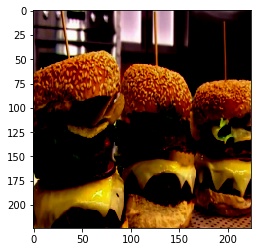

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


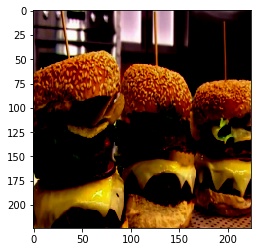

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


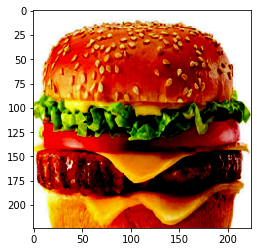

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


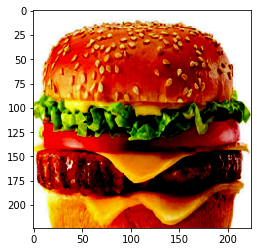

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


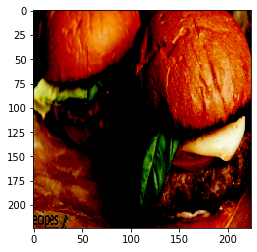

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


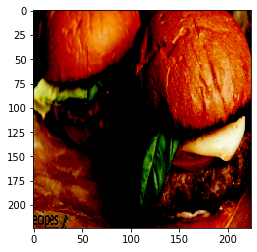

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


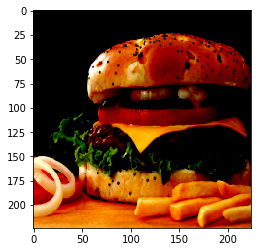

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


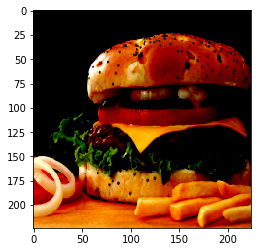

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


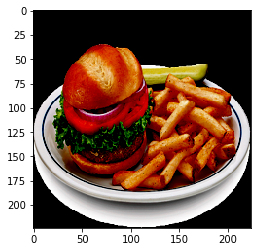

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


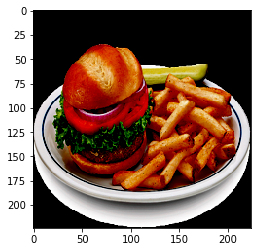

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


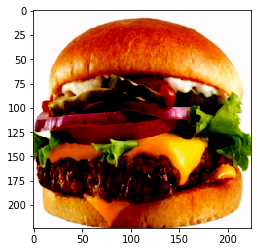

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


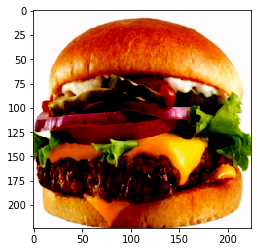

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


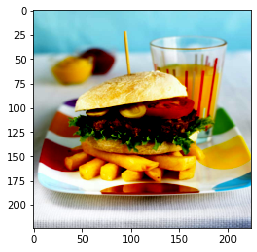

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


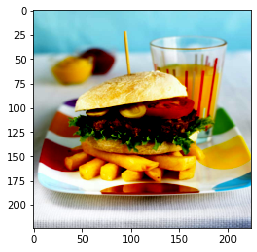

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


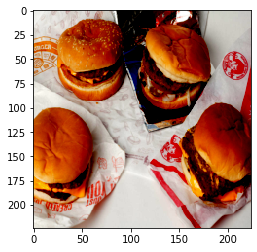

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


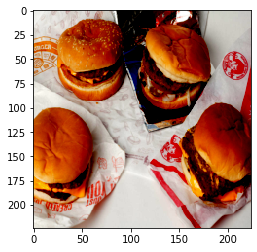

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


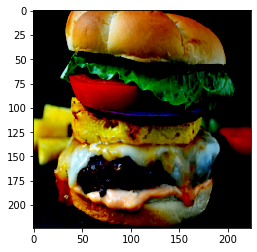

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


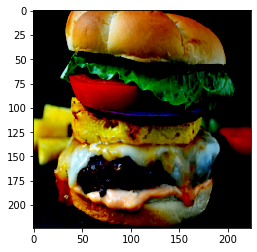

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


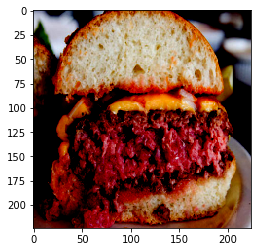

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


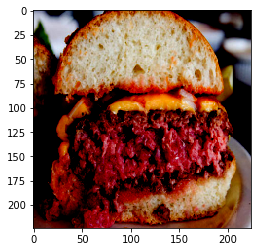

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


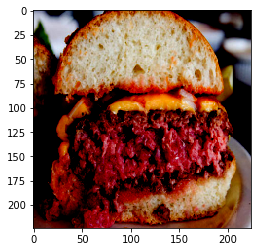

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


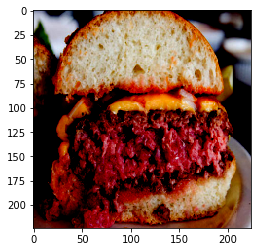

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


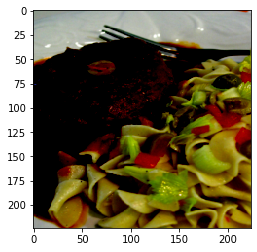

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


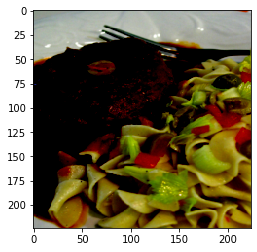

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


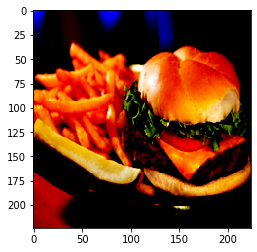

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


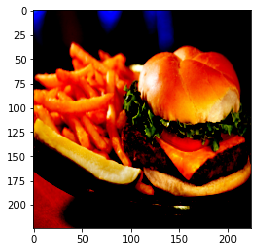

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


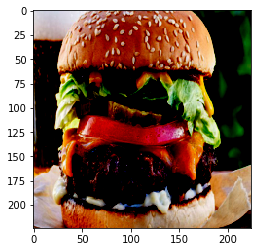

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


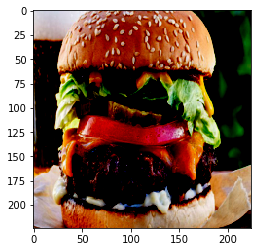

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


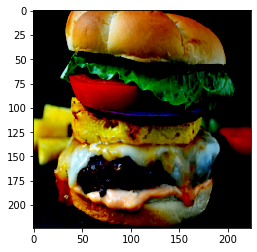

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


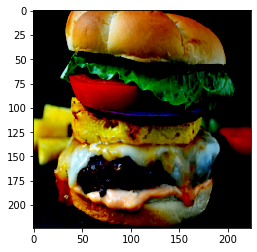

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


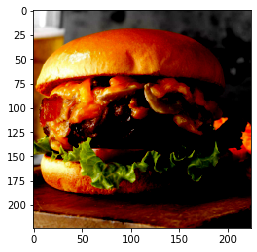

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


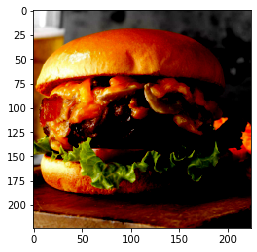

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


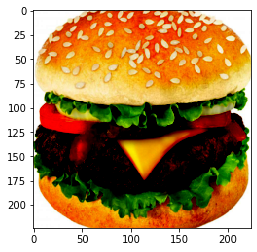

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


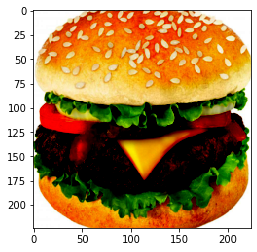

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


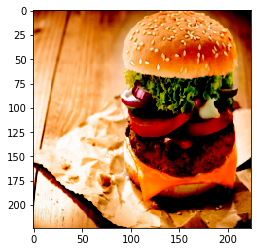

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


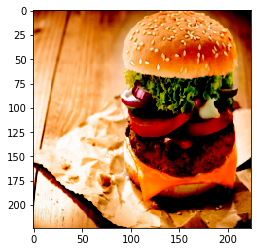

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


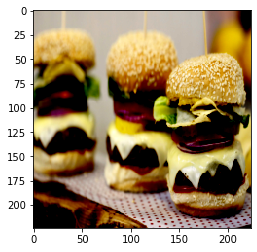

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


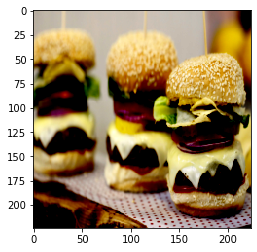

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


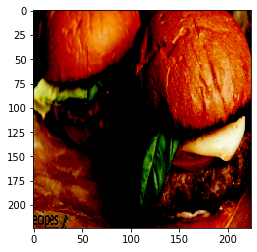

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


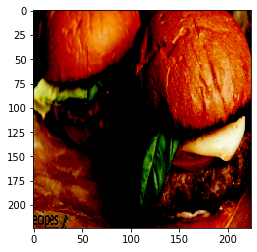

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


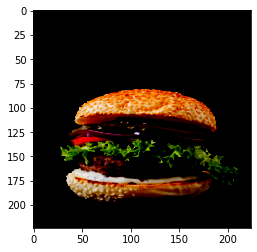

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


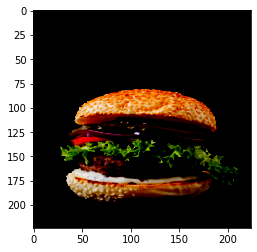

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


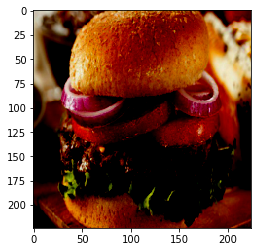

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


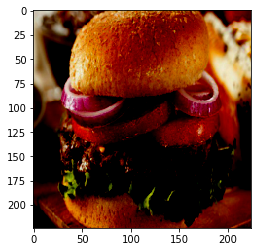

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


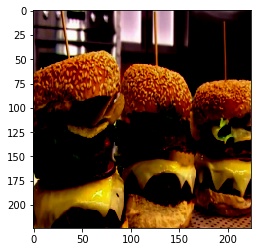

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


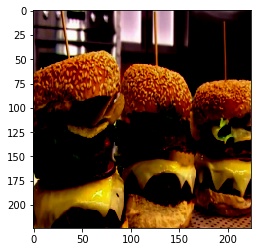

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


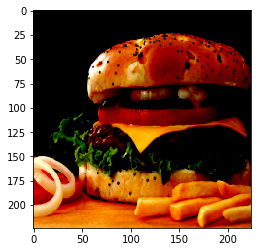

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


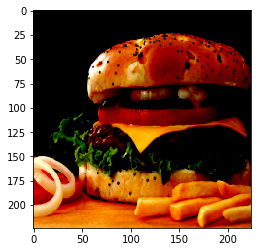

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


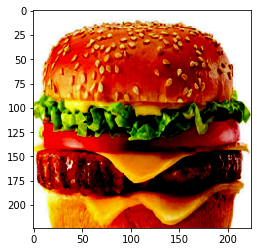

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


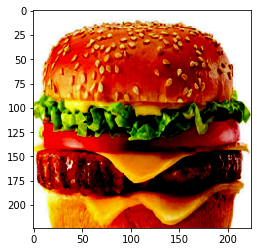

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


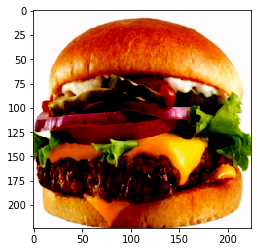

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


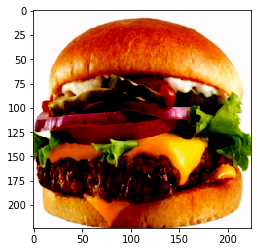

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


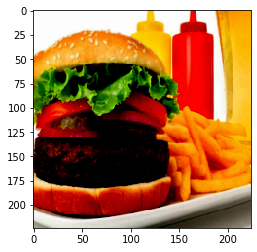

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


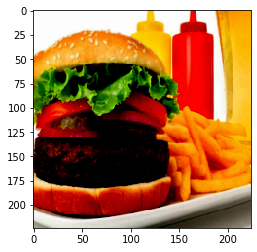

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


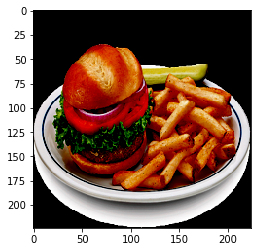

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


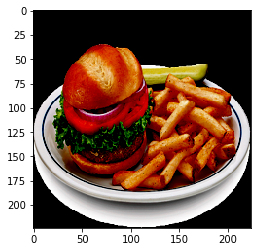

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


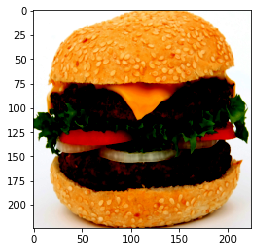

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


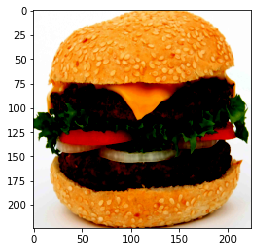

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


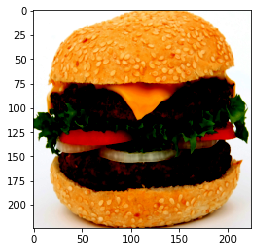

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


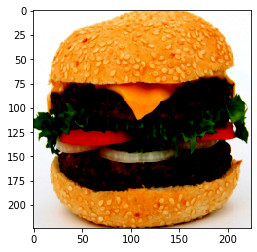

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


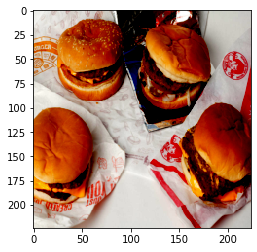

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


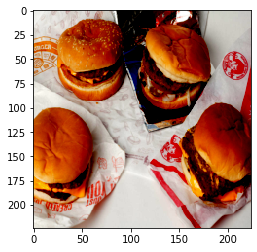

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


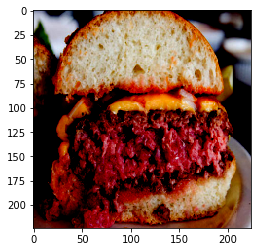

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


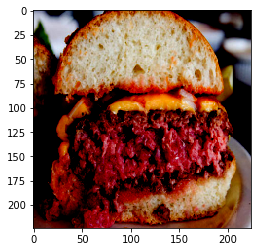

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


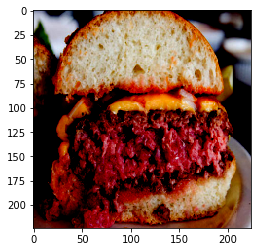

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


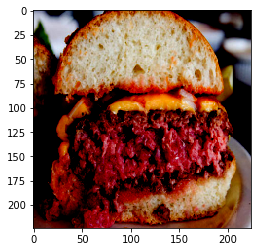

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


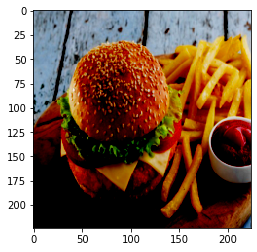

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


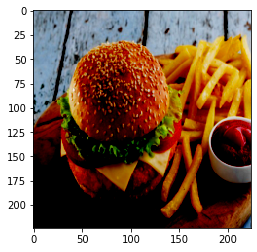

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


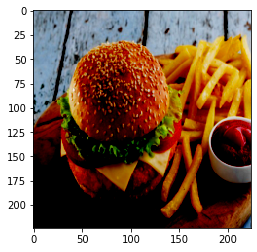

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


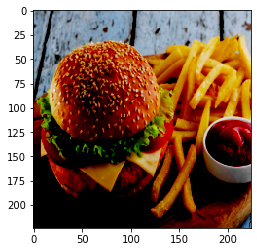

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


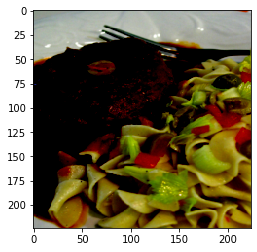

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


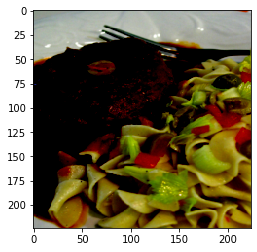

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


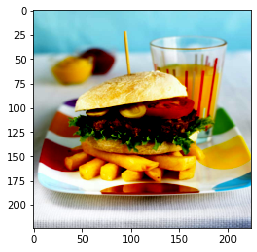

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


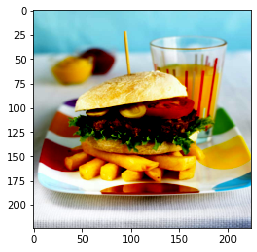

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


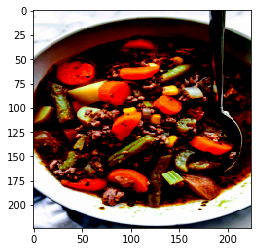

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


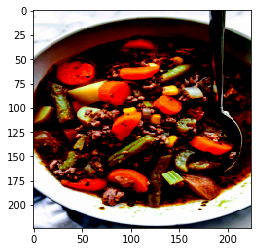

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


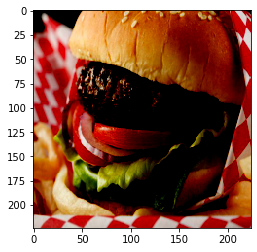

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


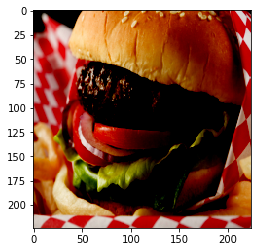

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


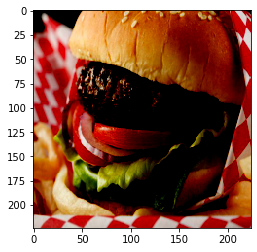

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


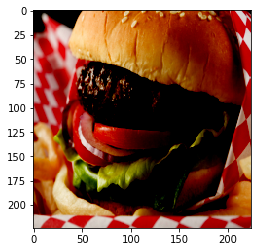

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


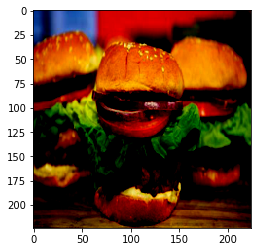

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


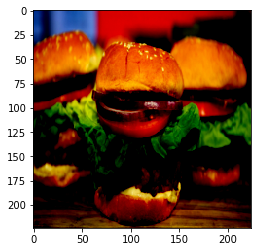

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


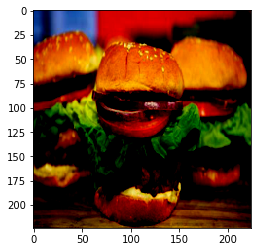

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


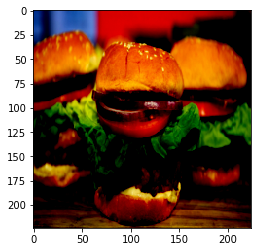

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


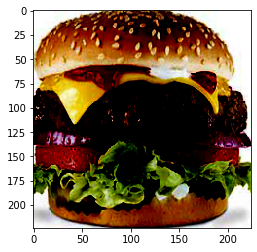

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


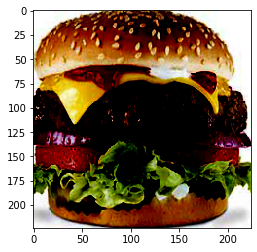

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


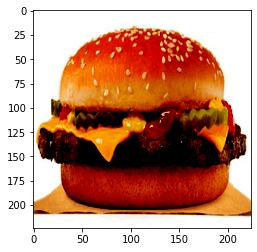

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


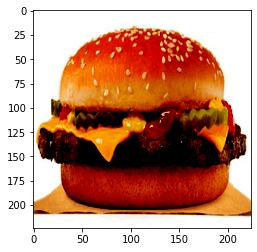

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


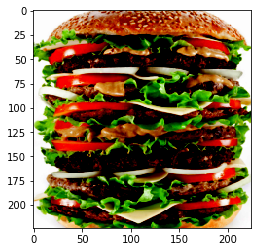

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


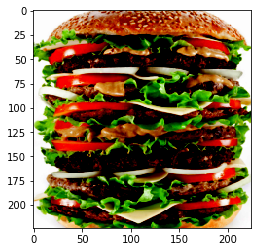

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


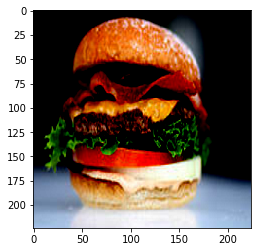

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


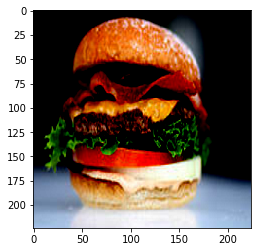

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


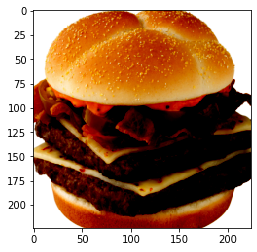

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


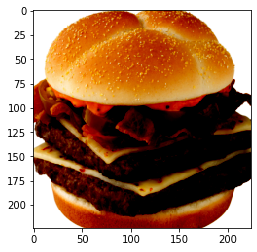

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


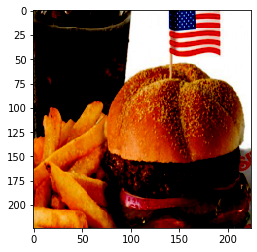

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


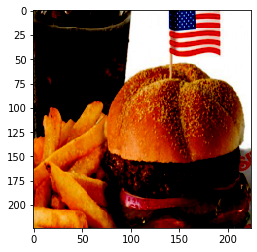

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


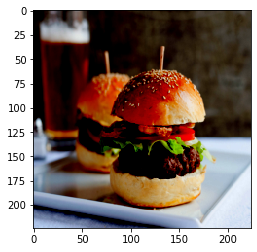

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


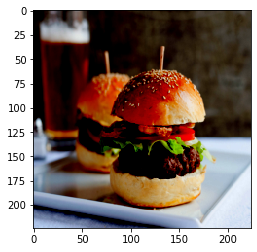

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


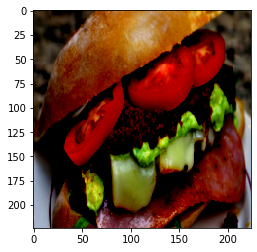

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


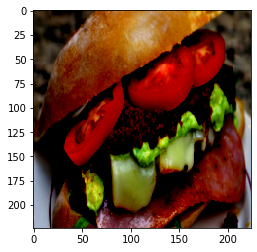

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


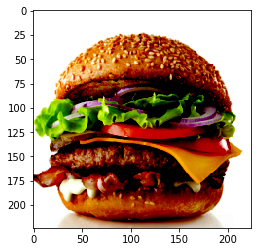

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


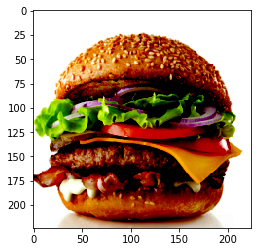

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


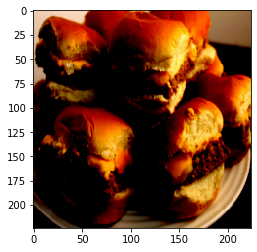

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


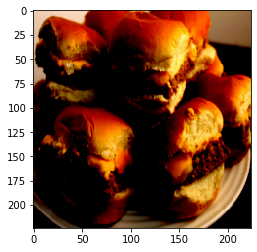

/home/neuralcrypto/anaconda3/lib/python3.7/site-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


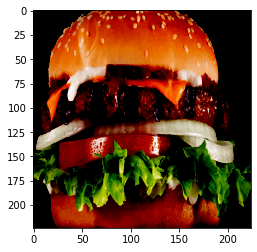

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


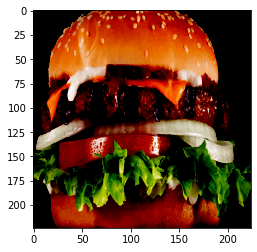

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


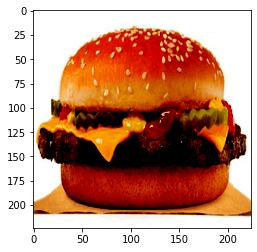

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


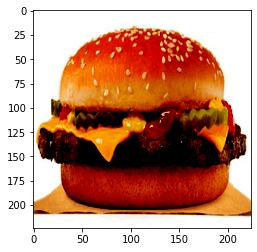

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


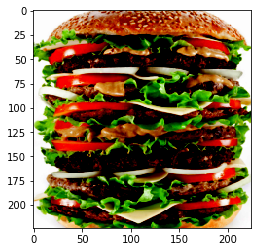

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


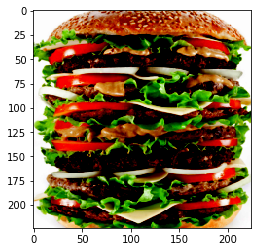

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


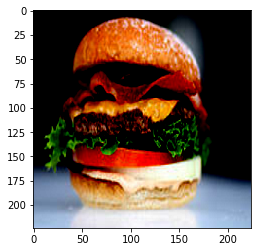

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


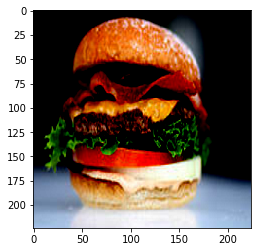

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


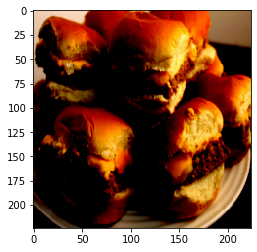

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


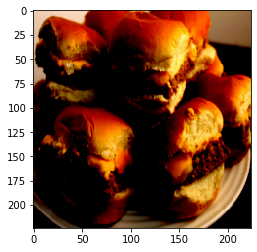

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


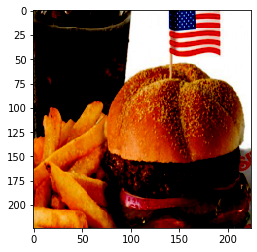

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


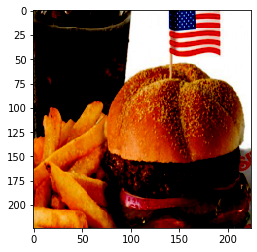

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


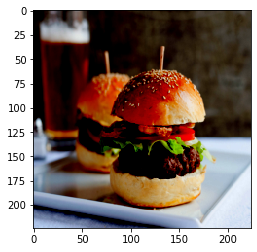

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


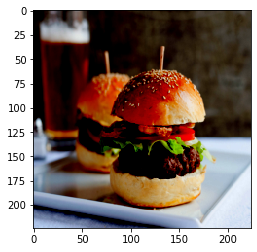

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


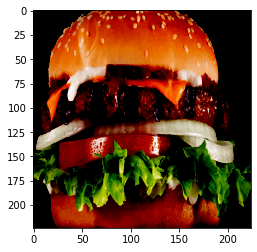

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


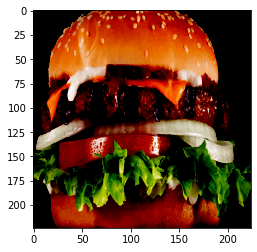

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


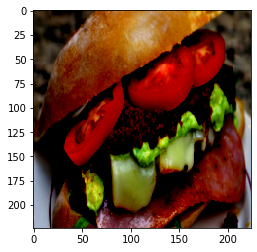

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


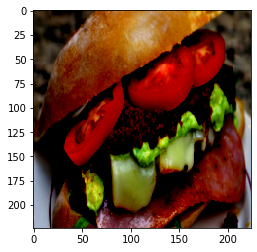

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


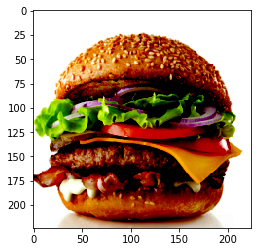

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


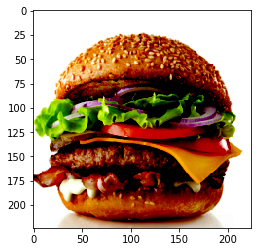

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


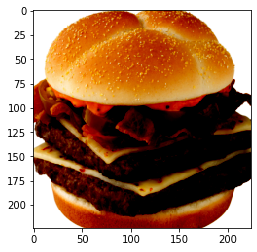

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


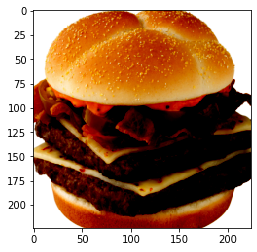

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


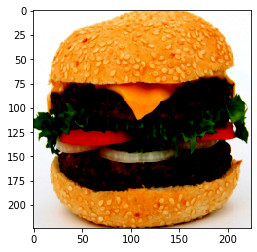

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


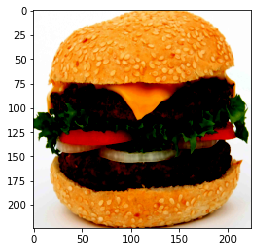

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


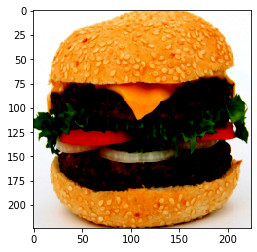

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


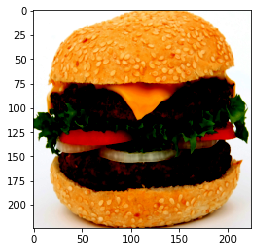

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


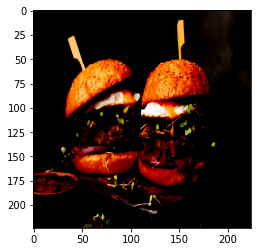

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


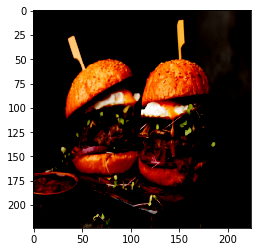

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


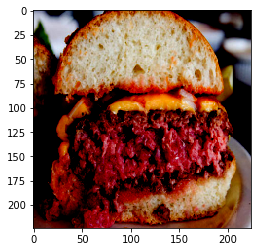

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


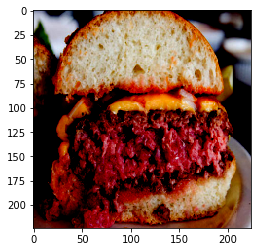

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


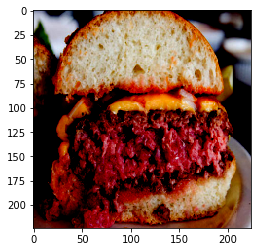

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


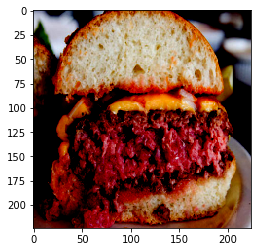

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


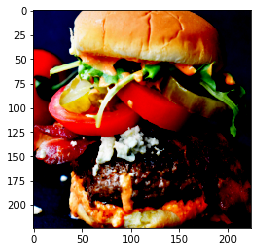

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


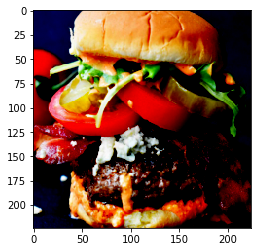

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


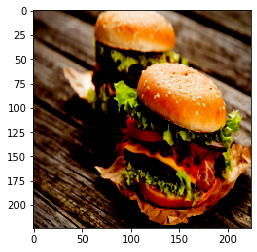

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


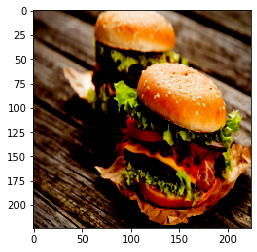

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


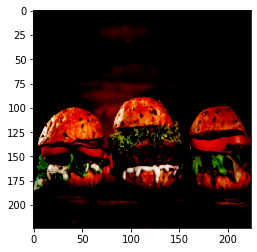

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


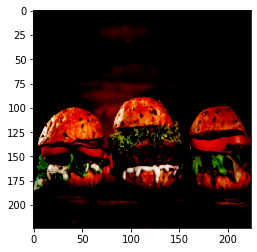

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


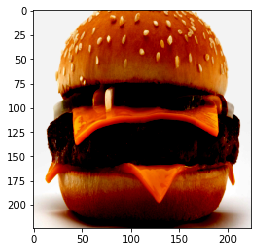

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


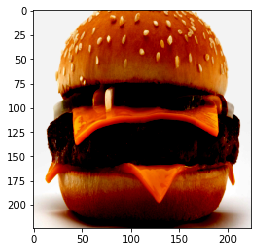

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


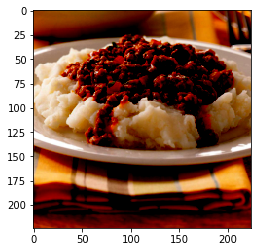

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


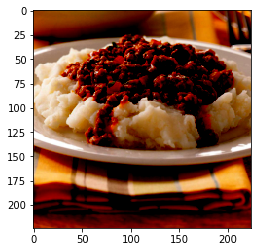

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


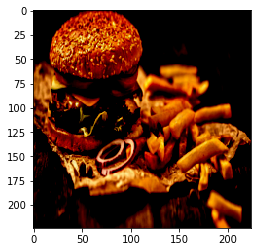

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


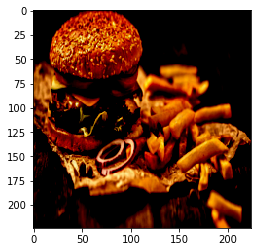

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


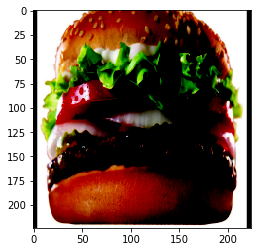

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


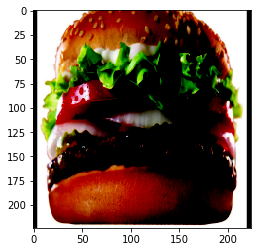

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


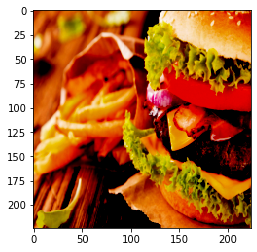

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


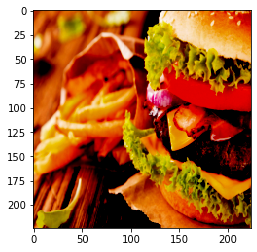

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


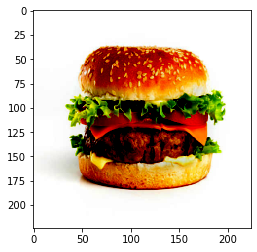

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


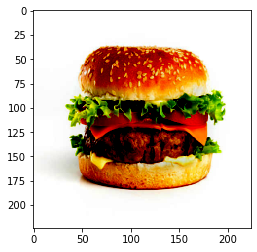

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


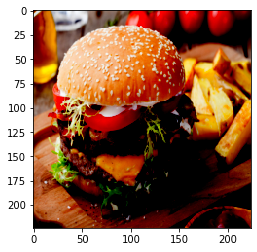

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


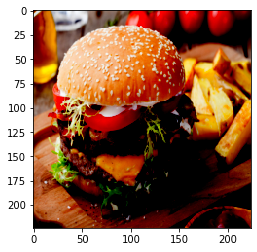

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


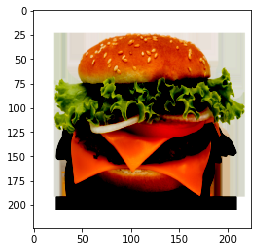

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


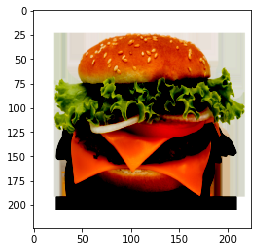

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


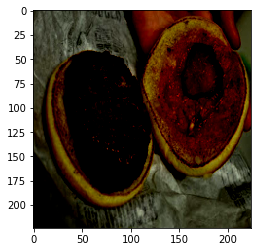

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


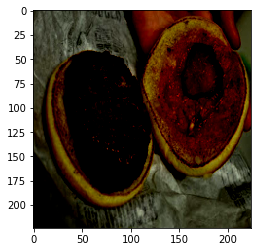

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


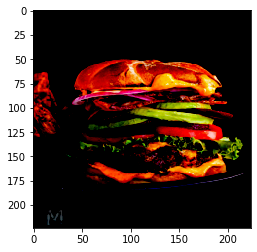

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


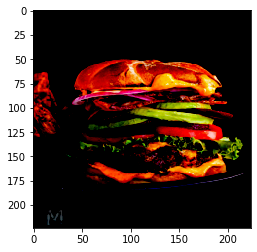

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


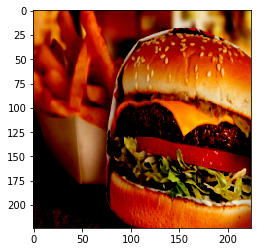

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


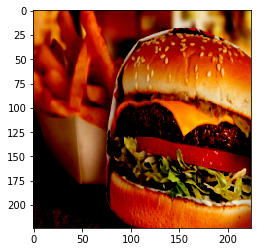

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


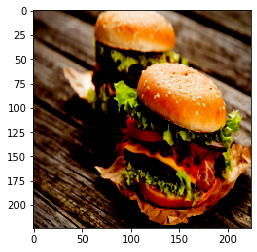

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


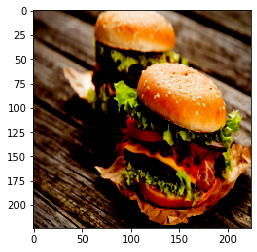

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


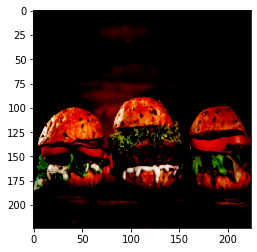

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


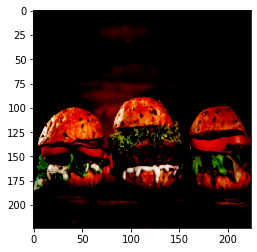

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


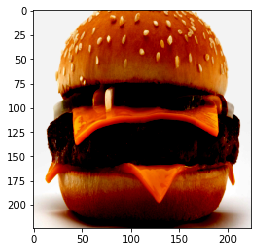

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


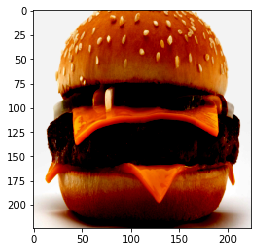

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


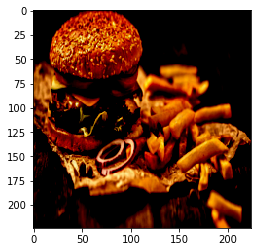

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


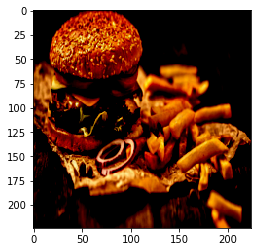

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


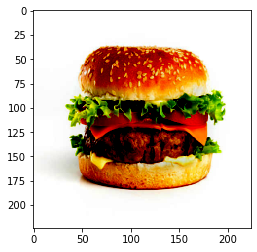

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


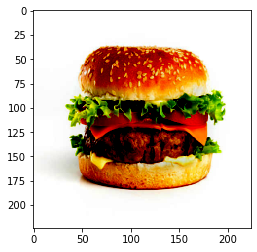

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


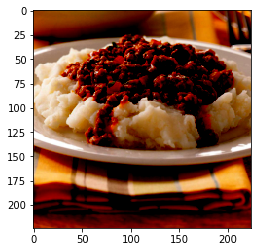

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


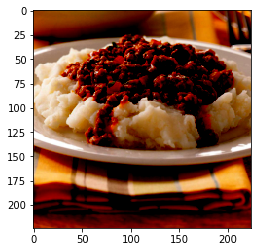

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


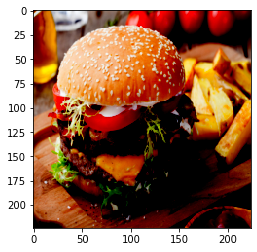

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


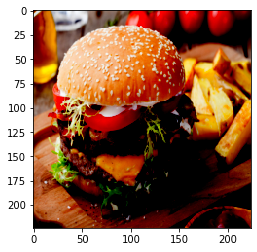

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


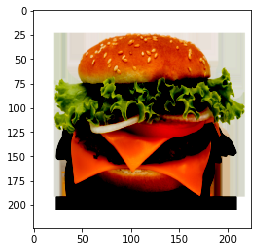

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


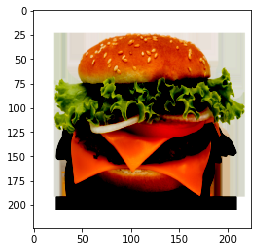

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


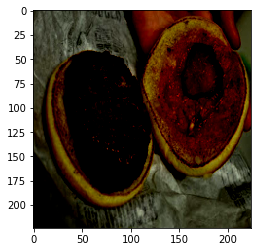

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


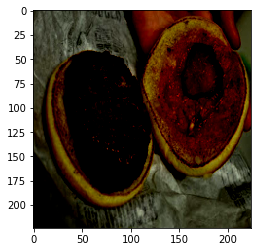

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


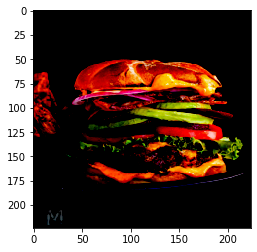

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


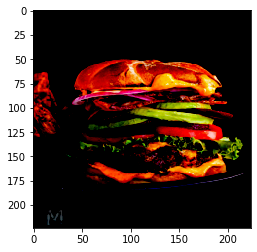

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


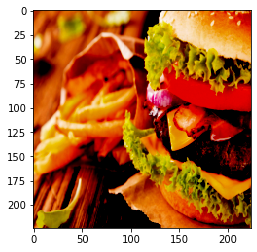

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


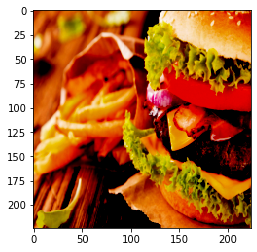

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


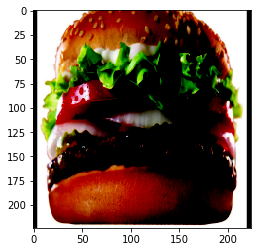

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


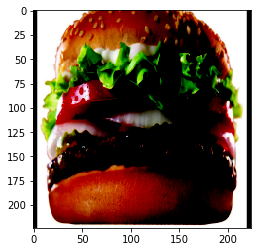

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


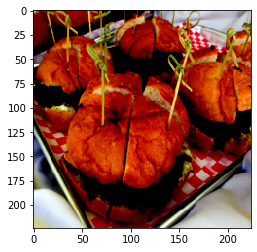

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


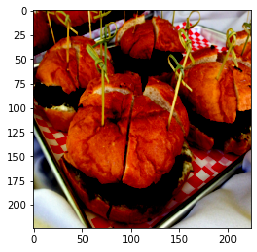

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


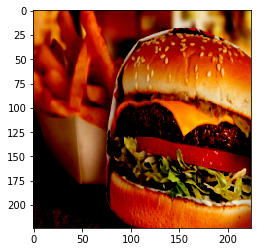

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


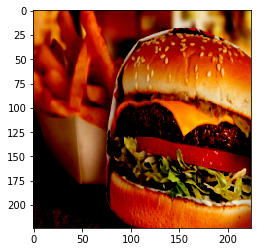

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


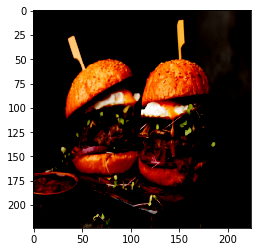

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


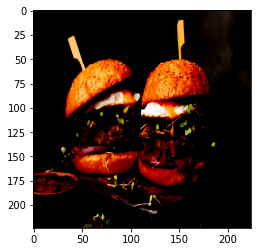

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


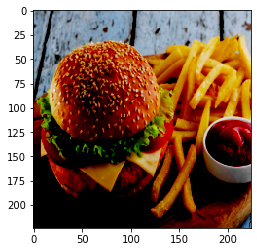

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


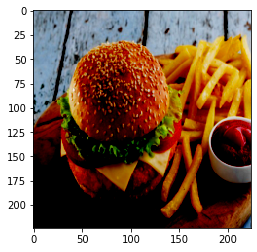

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


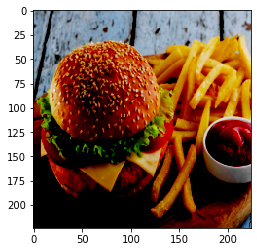

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


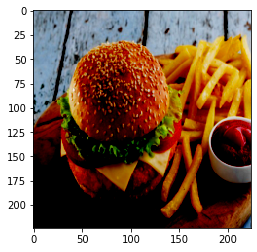

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


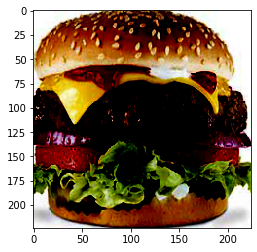

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


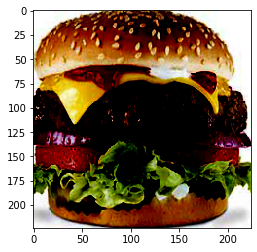

In [65]:
# for pair in pairs_repeated:
#     plt.imshow(dl_hamburger.dataset[pair[0]][0].permute([1, 2, 0]))
#     plt.show()
#     plt.imshow(dl_hamburger.dataset[pair[1]][0].permute([1, 2, 0]))
#     plt.show()

In [95]:
import pandas as pd

In [148]:
df_pairs = pd.DataFrame(pairs_repeated)

In [149]:
repeated_img = df_pairs.iloc[:, 1]

In [150]:
repeated_img.drop_duplicates().to_numpy()

array([206, 297, 185, 93, 103, 94, 98, 112, 238, 118, 102, 134, 119, 96,
       242, 135, 126, 105, 107, 111, 120, 77, 79, 86, 80, 83, 78, 89, 90,
       91, 81, 319, 82, 85, 92, 88, 84, 87, 383, 190, 229, 188, 209, 405,
       203, 198, 186, 189, 196, 192, 199, 201, 193, 200, 205, 202, 219,
       207, 187, 208, 313, 211, 66, 169, 182, 164, 170, 162, 173, 176,
       172, 168, 174, 177, 175, 179, 167, 178, 57, 181, 183, 166, 184,
       180, 163, 447, 277, 278, 279, 291, 281, 282, 284, 286, 280, 283,
       267, 268, 269, 275, 271, 272, 276, 273, 274, 270, 403, 117, 369,
       370, 371, 374, 372, 380, 379, 373, 375, 376, 377, 378, 384, 355,
       356, 357, 359, 363, 358, 364, 365, 366, 367, 361, 360, 137, 368,
       299, 246], dtype=object)

In [151]:
list_repeated = repeated_img.drop_duplicates().to_list()

In [152]:
list_repeated.index(57)

78

In [153]:
1 in list_repeated

False

In [154]:
def df_cleaner(x, y):
    if x in list_repeated:
        idx = list_repeated.index(y)
        list_repeated.pop(idx)
        return y
    else:
        return 'Repeated'

In [155]:
df_pairs.loc[:, 1] = df_pairs.apply(lambda x: df_cleaner(x.iloc[0], x.iloc[1]), axis=1)

In [156]:
df_pairs.loc[:, 1]

0           206
1           297
2           185
3            93
4           103
         ...   
147    Repeated
148    Repeated
149    Repeated
150    Repeated
151    Repeated
Name: 1, Length: 152, dtype: object

In [161]:
df_pairs[df_pairs.iloc[:, 1] != 'Repeated']

,0,1
0,57,206
1,57,297
2,66,185
3,77,93
4,78,103
...,...,...
129,364,375
130,365,376
131,366,377
132,367,378


## Cool, this is the same result as:

In [163]:
images_to_delete_np = np.array(list(set(images_to_delete)))
len(images_to_delete_np), images_to_delete_np

(71,
 array([384, 134, 135, 403, 405, 277, 278, 279, 281, 282, 280, 284, 283,
        286, 291, 378, 297, 185, 186, 187, 188, 189, 190, 319, 192, 193,
        313, 447, 196, 198, 199, 200, 201, 202, 203, 205, 206, 207, 208,
        209, 211, 219,  93,  94, 375,  96,  98, 376, 229, 102, 103, 105,
        377, 107, 238, 111, 112, 369, 242, 370, 371, 372, 118, 119, 120,
        374, 373, 379, 380, 126, 383]))

In [167]:
type(data_food_hamburger)

torchvision.datasets.folder.ImageFolder

In [181]:
(dl_hamburger.dataset.imgs[i][0]).rsplit('/', 1)[1]

'00000416.jpg'

In [235]:
%autoreload 2

In [236]:
from cleaning_duplicates import repeated_img_path

In [237]:
repeated_img_path(images_to_delete_np, dl_hamburger)

['00000417.jpg',
 '00000145.png',
 '00000146.jpg',
 '00000438.jpg',
 '00000440.jpg',
 '00000300.jpg',
 '00000301.jpg',
 '00000302.jpg',
 '00000304.jpg',
 '00000306.jpg',
 '00000303.jpg',
 '00000308.jpg',
 '00000307.png',
 '00000310.jpg',
 '00000316.jpg',
 '00000410.jpg',
 '00000323.jpg',
 '00000200.jpg',
 '00000201.jpg',
 '00000202.jpg',
 '00000203.jpg',
 '00000204.jpg',
 '00000207.jpg',
 '00000347.jpg',
 '00000209.jpg',
 '00000210.jpg',
 '00000340.jpg',
 '00000491.jpg',
 '00000214.jpg',
 '00000216.jpg',
 '00000217.jpg',
 '00000218.jpg',
 '00000219.jpg',
 '00000221.jpg',
 '00000222.jpg',
 '00000224.png',
 '00000225.jpeg',
 '00000226.jpg',
 '00000227.jpg',
 '00000228.jpg',
 '00000230.jpg',
 '00000239.jpg',
 '00000101.jpg',
 '00000103.jpeg',
 '00000407.jpg',
 '00000105.jpg',
 '00000107.jpg',
 '00000408.PNG',
 '00000249.jpg',
 '00000111.jpg',
 '00000112.jpg',
 '00000115.jpg',
 '00000409.jpg',
 '00000117.jpg',
 '00000258.jpg',
 '00000122.jpg',
 '00000123.jpg',
 '00000400.jpg',
 '00000264.j

In [221]:
%autoreload 2

In [222]:
delete_img_path = []
for i in images_to_delete_np:
    delete_img_path.append((dl_hamburger.dataset.imgs[i][0]).rsplit('/', 1)[1])

In [183]:
pwd

'/home/neuralcrypto/Desktop/DataScience_Projects/pizza_or_pasta'

## Now you need to go to the path of your files

In [223]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [212]:
from cleaning_duplicates import idx_repeated_images

In [214]:
idx_repeated_images(embedding_pics_hamburger)

array([384, 134, 135, 403, 405, 277, 278, 279, 281, 282, 280, 284, 283,
       286, 291, 378, 297, 185, 186, 187, 188, 189, 190, 319, 192, 193,
       313, 447, 196, 198, 199, 200, 201, 202, 203, 205, 206, 207, 208,
       209, 211, 219,  93,  94, 375,  96,  98, 376, 229, 102, 103, 105,
       377, 107, 238, 111, 112, 369, 242, 370, 371, 372, 118, 119, 120,
       374, 373, 379, 380, 126, 383])

In [184]:
import os

In [197]:
# os.listdir()

In [195]:
os.chdir('./hamburger/')

In [199]:
os.remove('00000137.jpg')

In [238]:
pwd

'/home/neuralcrypto/Desktop/DataScience_Projects/pizza_or_pasta/data/foods/foods2/hamburger2/hamburger'

In [240]:
from cleaning_duplicates import delete_repeated_img

In [241]:
delete_repeated_img(delete_img_path)

Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not de

In [203]:
for i in delete_img_path:
    if os.path.exists(i):
        os.remove(i)
    else:
        print("Can not delete the file as it doesn't exists")

Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not delete the file as it doesn't exists
Can not de